<a href="https://colab.research.google.com/github/electronjia/heart_cardiac_mri_image_processing/blob/main/edge_detection_and_contours/lv_edge_detection_single_pt.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#### Mahri
I will use dicom images because they preserve accurate pixel spacing and temporal ordering that might be needed for ejection fraction and motion tracking.

In [1]:
# On g collab only
!git clone https://github.com/electronjia/heart_cardiac_mri_image_processing.git

Cloning into 'heart_cardiac_mri_image_processing'...
remote: Enumerating objects: 15287, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 15287 (delta 0), reused 0 (delta 0), pack-reused 15282 (from 2)
Receiving objects: 100% (15287/15287), 827.47 MiB | 13.76 MiB/s, done.
Resolving deltas: 100% (952/952), done.
Updating files: 100% (13429/13429), done.


In [2]:
# On g collab only
!pip install pydicom

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 34.2 MB/s eta 0:00:00


In [3]:
# On g collab only
!pwd
!ls -l
%cd heart_cardiac_mri_image_processing/edge_detection_and_contours
!pwd

/content
total 8
drwxr-xr-x 7 root root 4096 Mar 29 18:07 heart_cardiac_mri_image_processing
drwxr-xr-x 1 root root 4096 Mar 24 13:34 sample_data
/content/heart_cardiac_mri_image_processing/edge_detection_and_contours
/content/heart_cardiac_mri_image_processing/edge_detection_and_contours


In [4]:
import pandas as pd
from config import *
import os
import numpy as np
from skimage import exposure, filters, measure, morphology
import matplotlib.pyplot as plt
import pydicom
from skimage import img_as_ubyte
from skimage.feature import canny
from skimage.measure import label, regionprops
import ipywidgets as widgets
from IPython.display import display
from skimage.draw import polygon

In [5]:
# On g collab only
import sys
sys.path.append('/content/heart_cardiac_mri_image_processing/edge_detection_and_contours')
user_handle = r"/content/heart_cardiac_mri_image_processing/data"
patient_data_excel_path = r"/content/heart_cardiac_mri_image_processing/scd_patientdata_xlsx.xlsx"
patient_data = "patient_data"
patient_filepaths = "patient_filepaths"

user_handle_g_collab = "/content/heart_cardiac_mri_image_processing/data"

Read the excel file with patient filepaths to start processing

In [ ]:
# Optimal parameters patients 0
disk_size = 1
sigma_blur = 0.2
clip_limit_val = 0.03
sigma_edge = 7.00
level_val = 0.7
patient_idx = 0


# Optimal parameters patient 1
# disk_size = 1
# sigma_blur = 0.2
# clip_limit_val = 0.03
# sigma_edge = 6
# level_val = 0.7
# patient_idx = 1

# Optimal parameters patient 2
# disk_size = 1
# sigma_blur = 0.2
# clip_limit_val = 0.03
# sigma_edge = 6.00
# level_val = 0.7
# patient_idx = 2


# Optimal parameters patient 3
# disk_size = 1
# sigma_blur = 0.2
# clip_limit_val = 0.03
# sigma_edge = 5.00
# level_val = 0.7
# patient_idx = 3

# Optimal parameters patient 4
# disk_size = 1
# sigma_blur = 0.2
# clip_limit_val = 0.03
# sigma_edge = 6.00
# level_val = 0.7


In [6]:
patient_xlsx = patient_data_excel_path
patient_data_df = pd.read_excel(patient_xlsx, sheet_name=patient_data)
patient_filepaths_df = pd.read_excel(patient_xlsx, sheet_name=patient_filepaths)
patient_mask_filepaths = pd.read_excel(patient_xlsx, sheet_name="mask_filepaths")

display(patient_data_df.head(2))
display(patient_filepaths_df.head(2))

,patient_id,original_id,gender,age,pathology,filepath,gif_filepath
0,SCD0000101,SC-HF-I-1,Male,53,Heart failure with infarct,SCD_IMAGES_01\SCD0000101\CINESAX_300,SCD_IMAGES_01\SCD0000101\SCD0000101_gif.gif
1,SCD0000201,SC-HF-I-2,Male,48,Heart failure with infarct,SCD_IMAGES_01\SCD0000201\CINESAX_300,SCD_IMAGES_01\SCD0000201\SCD0000201_gif.gif


,patient_id,dcm_image_filepath
0,SCD0000101,SCD_IMAGES_01\SCD0000101\CINESAX_300\IM-0003-0...
1,SCD0000101,SCD_IMAGES_01\SCD0000101\CINESAX_300\IM-0003-0...


# Experiment with one patient

Conversion to single grayscale in case the dicom cine short axis mri images are not single channel grayscale type

In [ ]:
# Single patient

patient_ids = patient_filepaths_df['patient_id'].unique()
patient_id = patient_ids[patient_idx]
single_patient_filepaths = patient_filepaths_df.loc[patient_filepaths_df['patient_id'] == patient_id, 'dcm_image_filepath'].tolist()


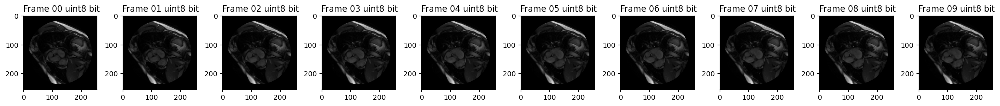

KeyboardInterrupt: 

In [ ]:
num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Plot processed image
        axes[idx].imshow(image, cmap="gray", vmin=np.min(image), vmax=np.max(image))
        axes[idx].set(title=f" Frame {batch_idx}{idx} {image.dtype} bit")

    plt.tight_layout()
    plt.show()

Filter out the noise from the image using gaussian filter

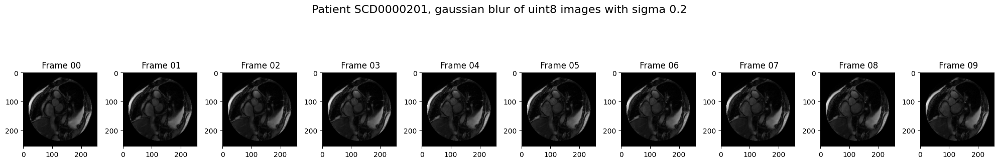

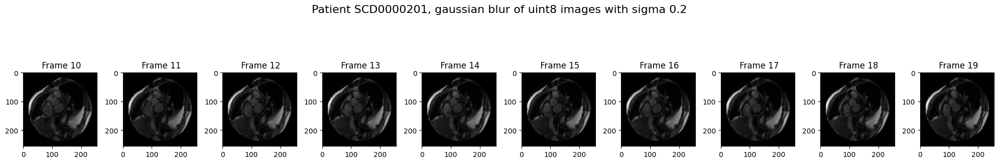

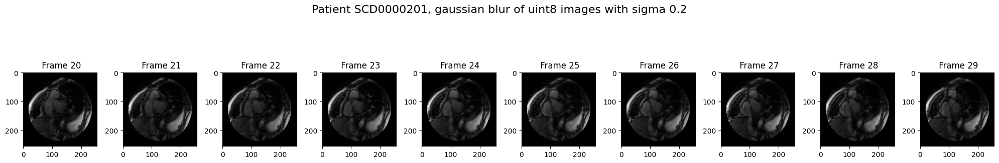

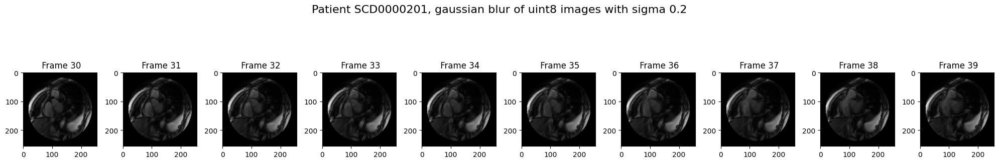

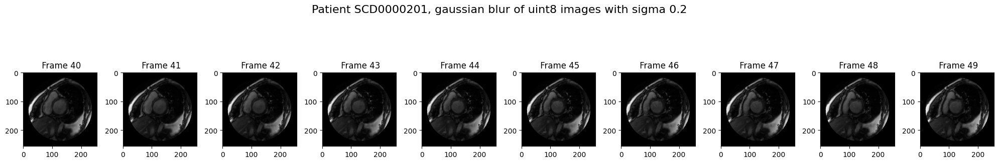

...

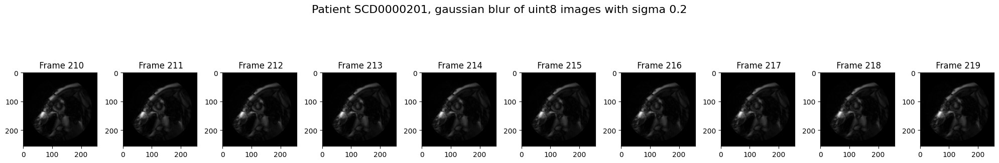

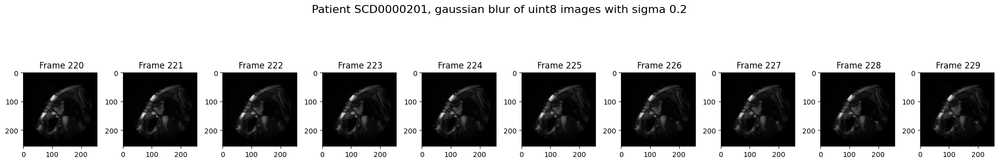

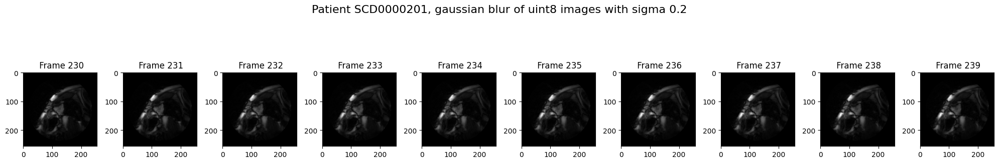

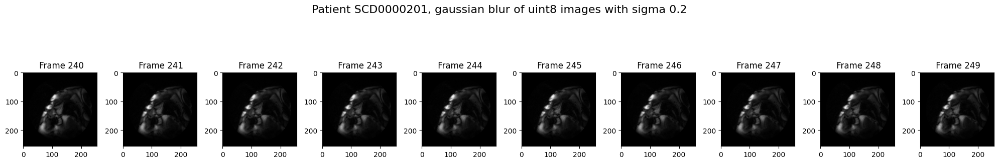

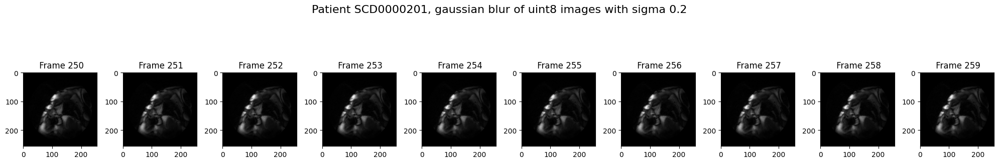

In [ ]:
# num_cols = 10  # Number of images per row

# # Process images in batches of 10
# for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
#     batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
#     num_images = len(batch_filepaths)

#     fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
#     if num_images == 1:
#         axes = [axes]  # Ensure axes is iterable when there's only one image

#     for idx, img_ex_filepath in enumerate(batch_filepaths):
#         # For Google Colab only
#         img_ex_filepath = img_ex_filepath.replace("\\", "/")
#         img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

#         # Read the DICOM image
#         dicom_image = pydicom.dcmread(img_abs_filepath)

#         # Extract the pixel data and convert to 8-bit image
#         image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

#         # Apply gaussian filter
#         image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

#         # Plot processed image
#         axes[idx].imshow(image_blurred_gaus, cmap="gray", vmin=np.min(image_blurred_gaus), vmax=np.max(image_blurred_gaus))
#         axes[idx].set(title=f" Frame {batch_idx}{idx}")

#     plt.suptitle(f"Patient {patient_id}, gaussian blur of uint8 images with sigma {sigma_blur}", fontsize=16)
#     plt.tight_layout()
#     plt.show()



Enhance contract using CLAHE (contrast limited adaptive histogram equalization)

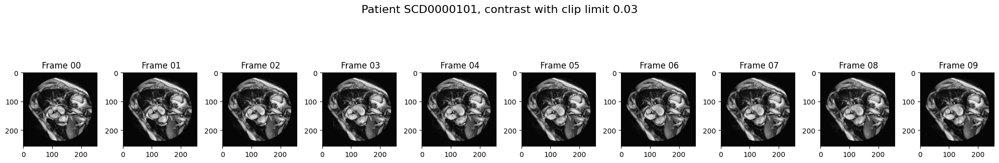

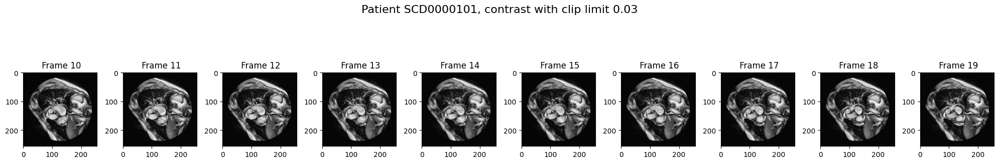

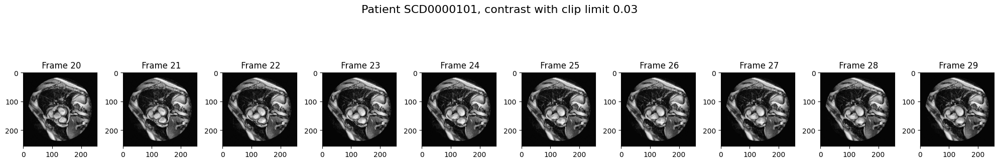

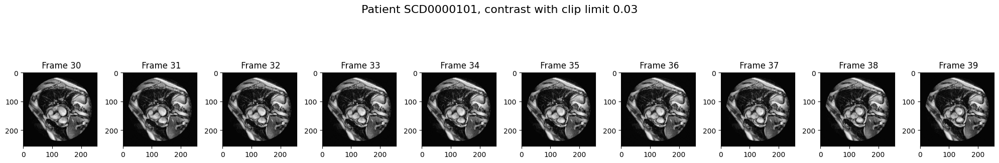

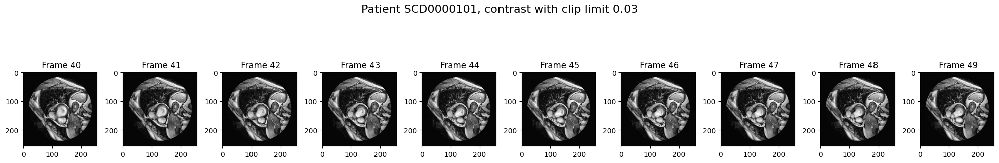

...

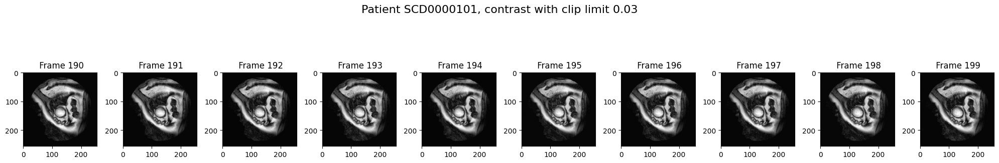

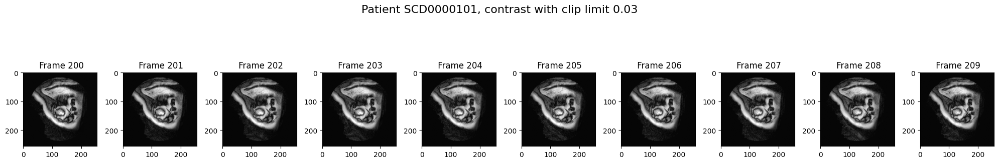

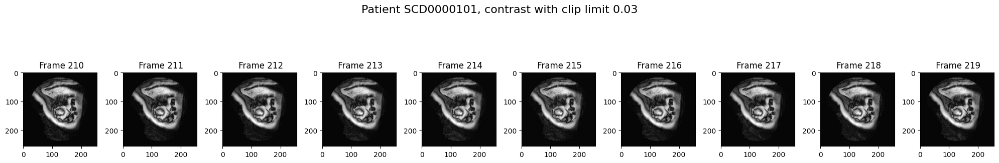

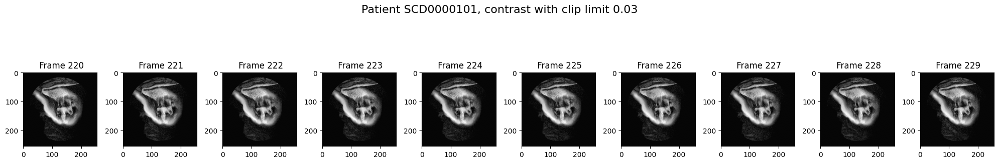

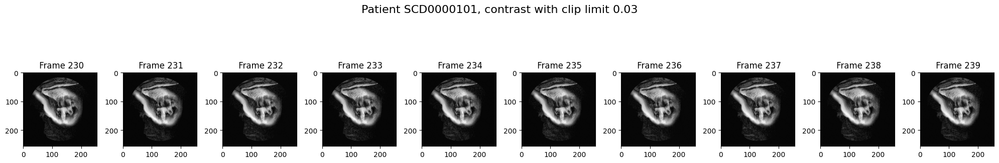

In [ ]:

# num_cols = 10  # Number of images per row

# # Process images in batches of 10
# for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
#     batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
#     num_images = len(batch_filepaths)

#     fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
#     if num_images == 1:
#         axes = [axes]  # Ensure axes is iterable when there's only one image

#     for idx, img_ex_filepath in enumerate(batch_filepaths):
#         # For Google Colab only
#         img_ex_filepath = img_ex_filepath.replace("\\", "/")
#         img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

#         # Read the DICOM image
#         dicom_image = pydicom.dcmread(img_abs_filepath)

#         # Extract the pixel data and convert to 8-bit image
#         image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

#         # Apply gaussian filter
#         image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

#         # Apply contrast
#         img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

#         # Plot processed image
#         axes[idx].imshow(img_contrast_gaus, cmap="gray", vmin=np.min(img_contrast_gaus), vmax=np.max(img_contrast_gaus))
#         axes[idx].set(title=f" Frame {batch_idx}{idx}")

#     plt.suptitle(f"Patient {patient_id}, contrast with clip limit {clip_limit_val}", fontsize=16)
#     plt.tight_layout()
#     plt.show()

As we can see in the above results, both gaussian and median filters provide good results. I will continue with gaussian filtering.

Edge detection with Canny function

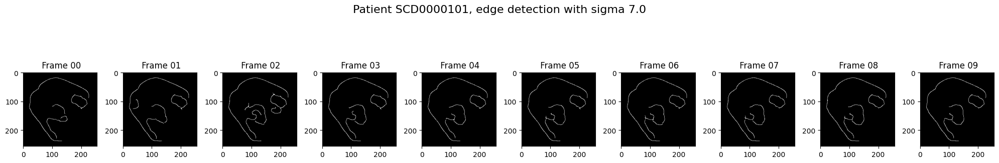

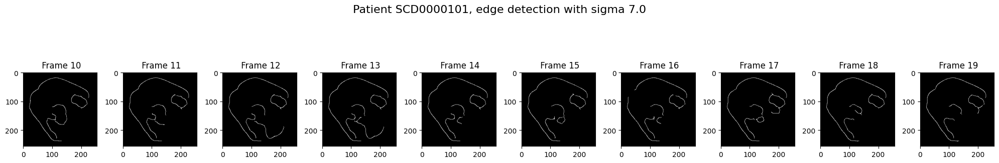

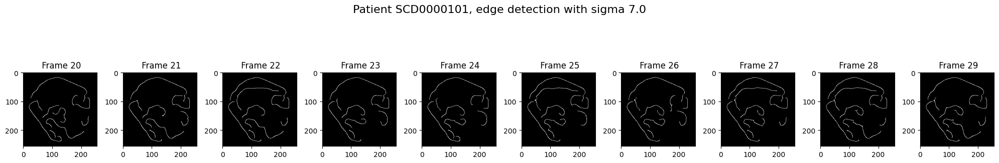

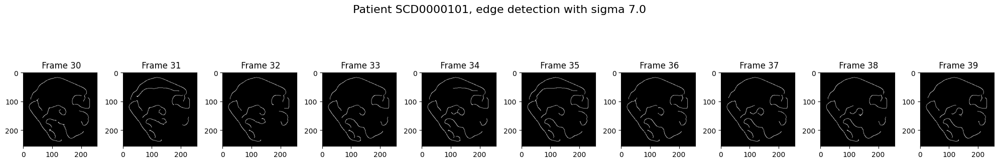

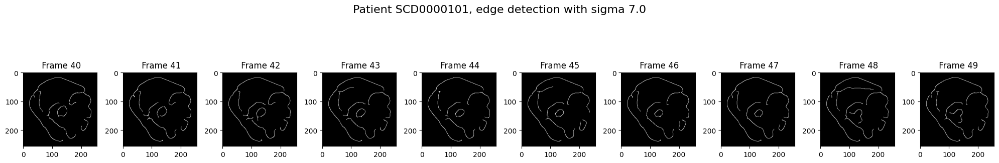

...

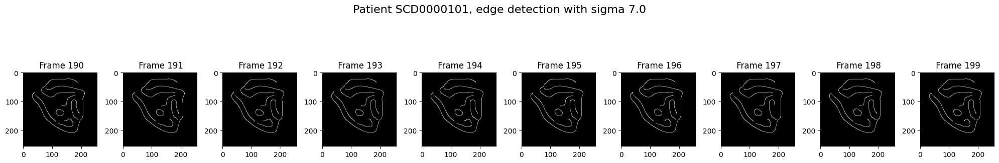

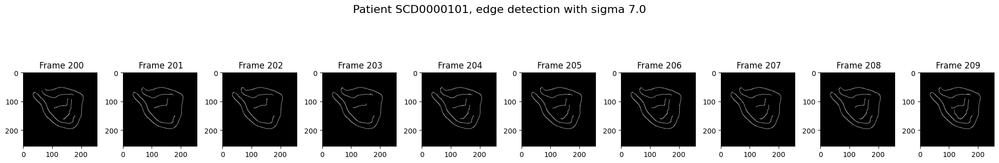

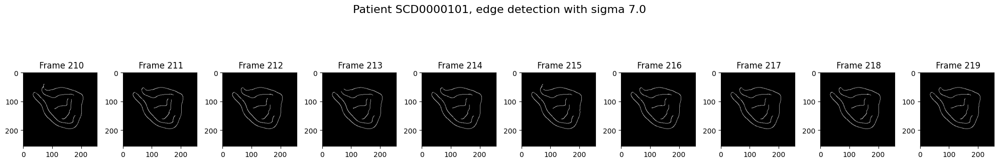

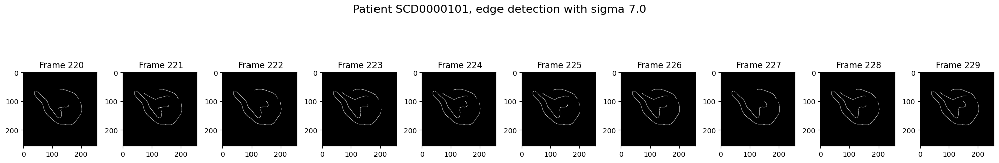

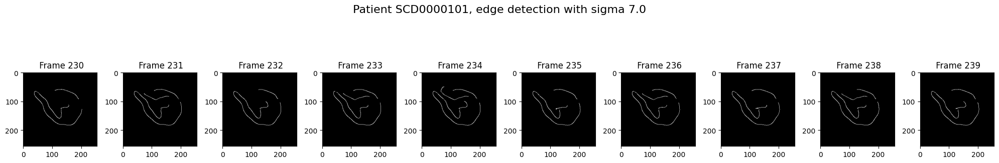

In [ ]:

# num_cols = 10  # Number of images per row

# # Process images in batches of 10
# for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
#     batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
#     num_images = len(batch_filepaths)

#     fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
#     if num_images == 1:
#         axes = [axes]  # Ensure axes is iterable when there's only one image

#     for idx, img_ex_filepath in enumerate(batch_filepaths):
#         # For Google Colab only
#         img_ex_filepath = img_ex_filepath.replace("\\", "/")
#         img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

#         # Read the DICOM image
#         dicom_image = pydicom.dcmread(img_abs_filepath)

#         # Extract the pixel data and convert to 8-bit image
#         image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

#         # Apply gaussian filter
#         image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

#         # Apply contrast
#         img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

#         # Edge detection
#         edges_gaus = canny(img_contrast_gaus, sigma=sigma_edge)

#         # Plot processed image
#         axes[idx].imshow(edges_gaus, cmap="gray", vmin=np.min(edges_gaus), vmax=np.max(edges_gaus))
#         axes[idx].set(title=f" Frame {batch_idx}{idx}")

#     plt.suptitle(f"Patient {patient_id}, edge detection with sigma {sigma_edge}", fontsize=16)
#     plt.tight_layout()
#     plt.show()


Find and draw the contours

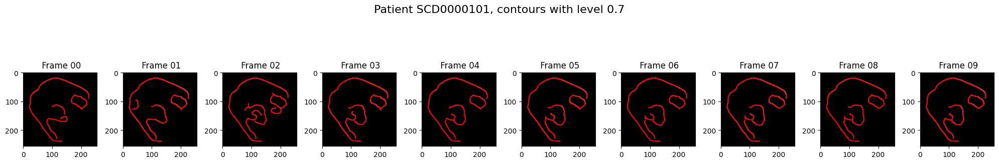

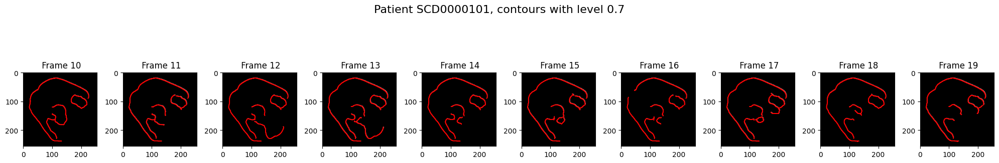

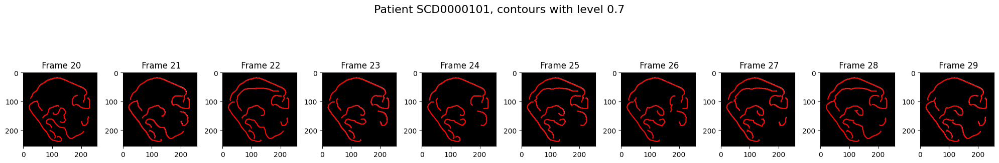

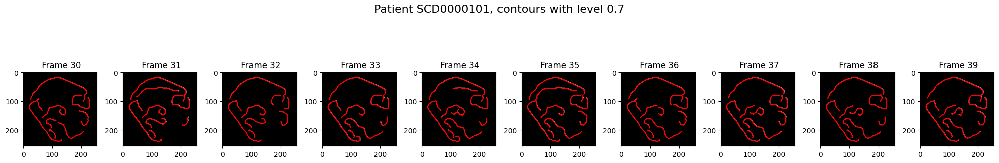

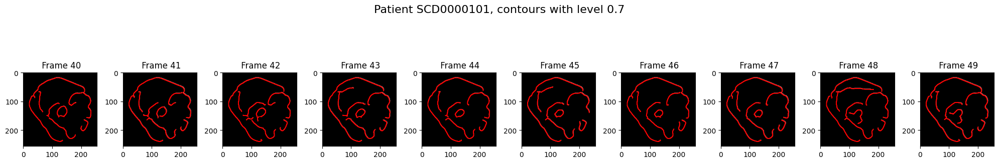

...

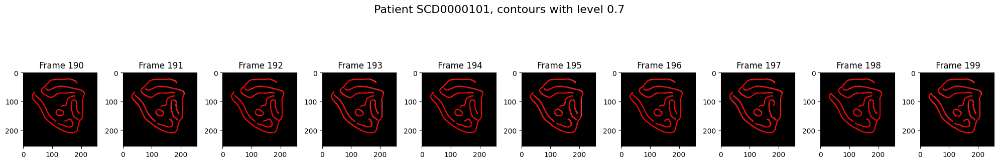

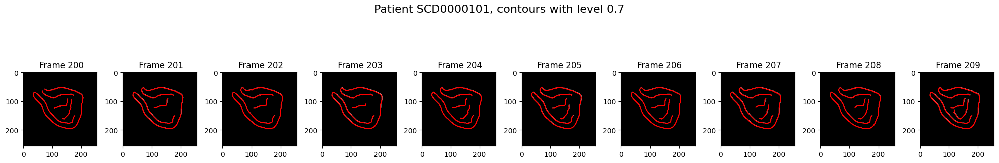

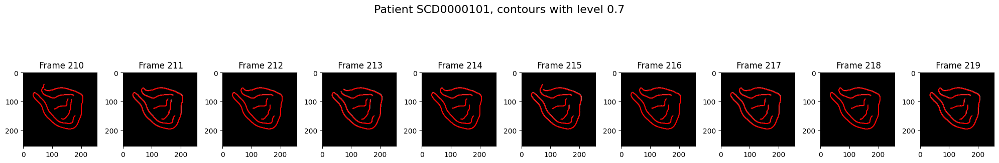

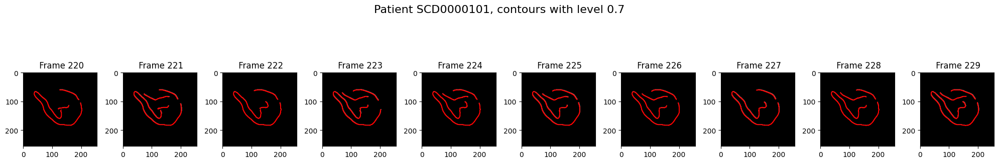

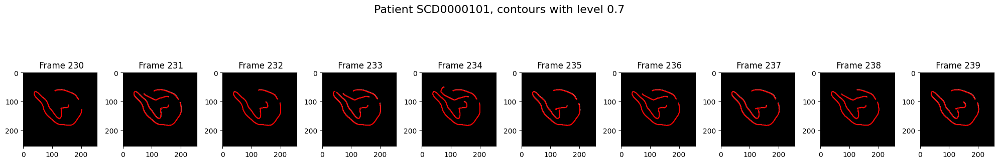

In [ ]:

# num_cols = 10  # Number of images per row

# # Process images in batches of 10
# for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
#     batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
#     num_images = len(batch_filepaths)

#     fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
#     if num_images == 1:
#         axes = [axes]  # Ensure axes is iterable when there's only one image

#     for idx, img_ex_filepath in enumerate(batch_filepaths):
#         # For Google Colab only
#         img_ex_filepath = img_ex_filepath.replace("\\", "/")
#         img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

#         # Read the DICOM image
#         dicom_image = pydicom.dcmread(img_abs_filepath)

#         # Extract the pixel data and convert to 8-bit image
#         image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

#         # Apply gaussian filter
#         image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

#         # Apply contrast
#         img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

#         # Edge detection
#         edges_gaus = canny(img_contrast_gaus, sigma=sigma_edge)

#         # Find and draw contours
#         contours = measure.find_contours(edges_gaus, level=level_val)

#         # Plot processed image
#         axes[idx].imshow(edges_gaus, cmap="gray", vmin=np.min(edges_gaus), vmax=np.max(edges_gaus))

#         for contour in contours:
#             axes[idx].plot(contour[:, 1], contour[:, 0], color='r', linewidth=1)  # Plot contours

#         axes[idx].set(title=f" Frame {batch_idx}{idx}")

#     plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
#     plt.tight_layout()
#     plt.show()

As we can see, the ventricle does get enclosed but there are a lot of other things as well. I will try to extract the circles in the edge detected image.

Create a binary mask with contours being at the foreground

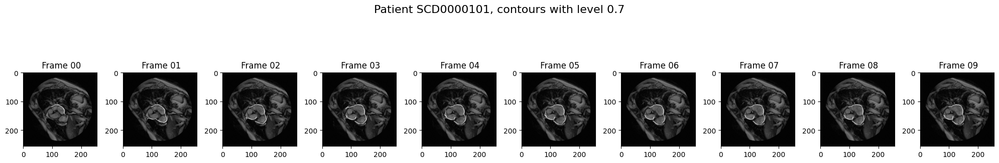

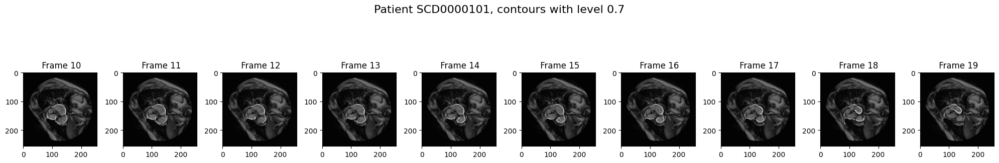

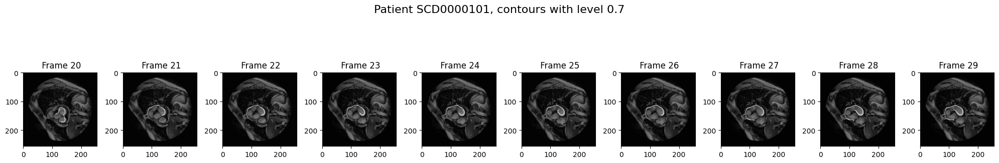

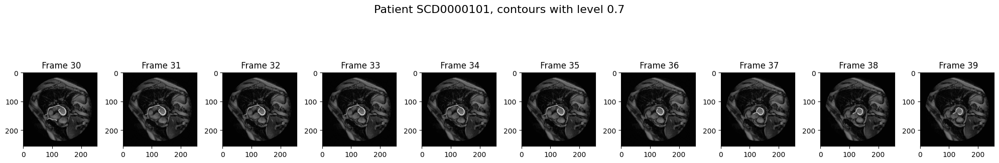

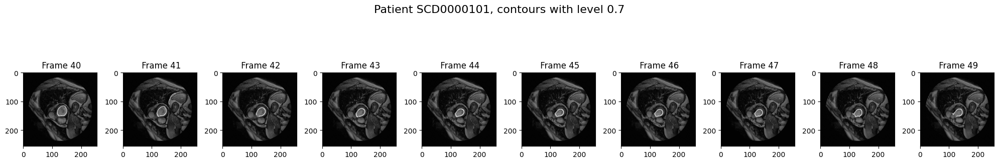

...

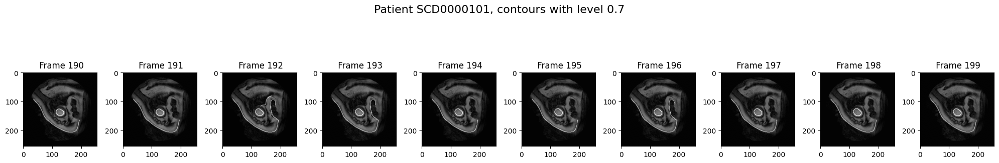

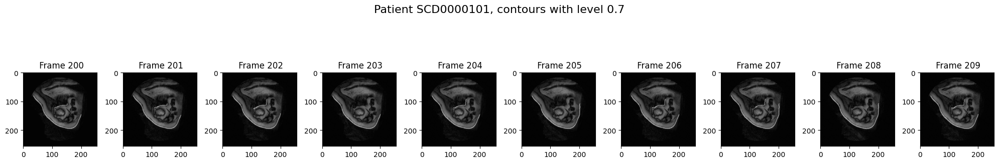

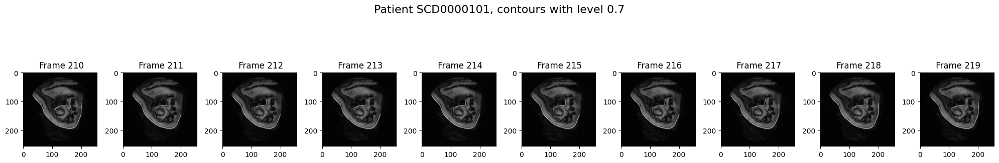

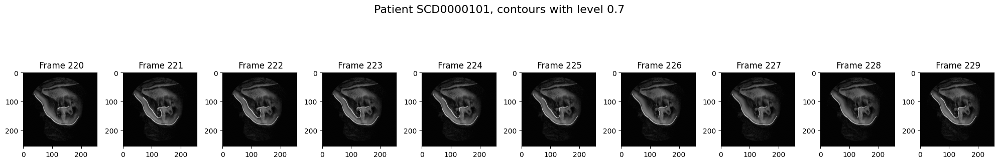

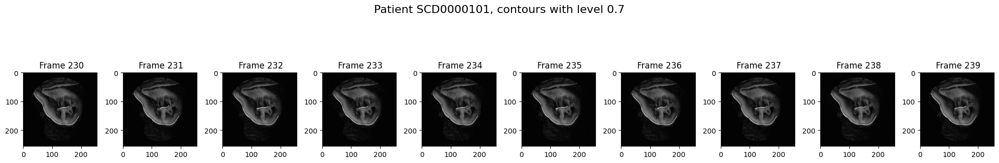

In [ ]:
num_cols = 10  # Number of images per row

# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Create radial mask for center contrast enhancement
        # Create a grid of distances from the center
        rows, cols = img_contrast_gaus.shape
        center_row, center_col = rows // 2, cols // 2

        # Create radial distance map
        y, x = np.ogrid[:rows, :cols]
        distance_from_center = np.sqrt((x - center_col)**2 + (y - center_row)**2)

        # Normalize distance to range [0, 1]
        distance_from_center = distance_from_center / np.max(distance_from_center)

        # Apply the mask (higher values in the center)
        radial_mask = 1 - distance_from_center  # Invert to get higher values at the center
        enhanced_contrast_image = img_contrast_gaus * radial_mask

        # Edge detection
        edges_gaus = canny(enhanced_contrast_image, sigma=sigma_edge)

        # Find and draw contours
        contours = measure.find_contours(edges_gaus, level=level_val)

        # Create a binary mask with contours
        binary_contours_image = np.zeros_like(image, dtype=np.uint8)
        for contour in contours:
            # Convert contour to polygon coordinates and fill it in the binary image
            contour_points = contour.astype(int)
            rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=binary_contours_image.shape)
            binary_contours_image[rr, cc] = 255  # Set contour area to foreground (255)

        # Plot processed image
        axes[idx].imshow(img_contrast_gaus, cmap="gray", vmin=np.min(img_contrast_gaus), vmax=np.max(img_contrast_gaus))
        axes[idx].imshow(binary_contours_image, cmap="gray", vmin=np.min(binary_contours_image), vmax=np.max(binary_contours_image), alpha=0.5)  # Overlay contours on the image
        axes[idx].set(title=f" Frame {batch_idx}{idx}")

    plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
    plt.tight_layout()
    plt.show()

I will find labels in the binary mask, measure region properties and evaluate eccentricity of every region.

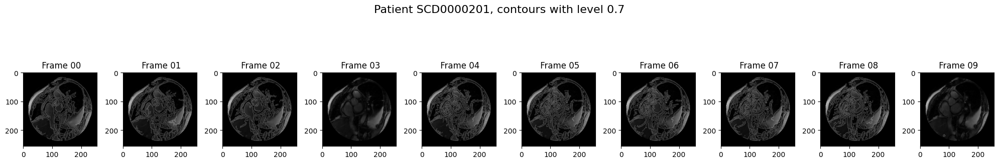

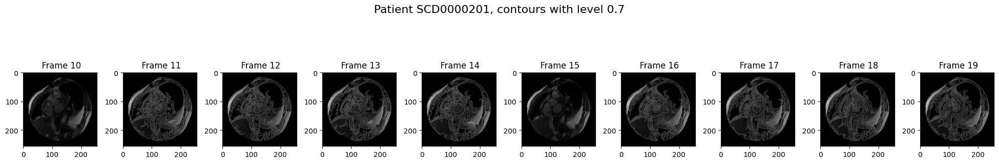

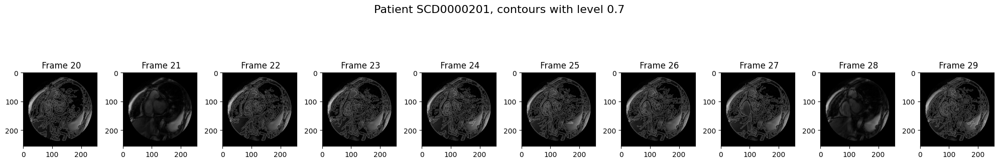

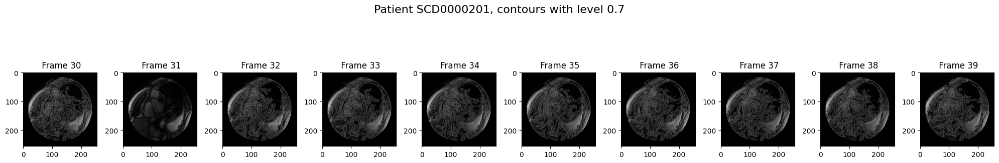

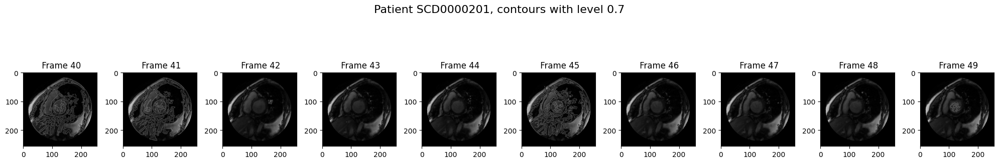

...

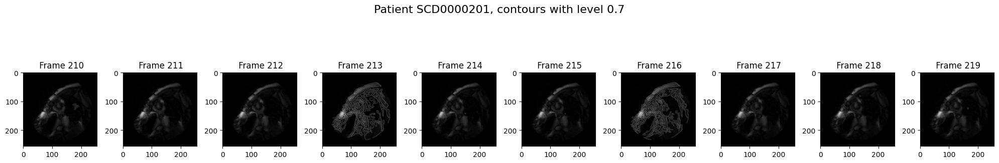

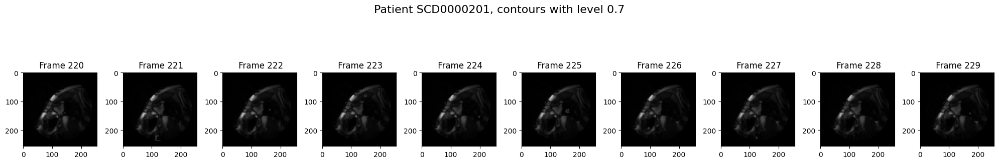

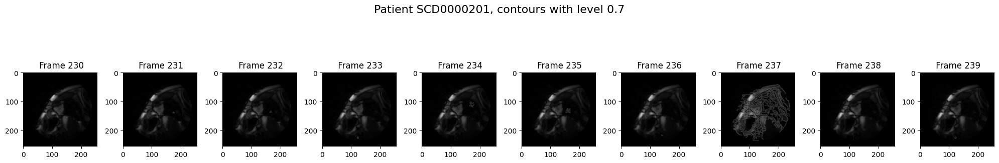

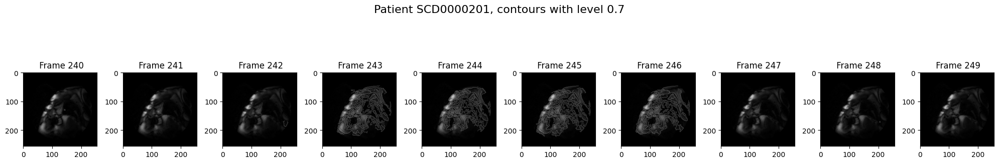

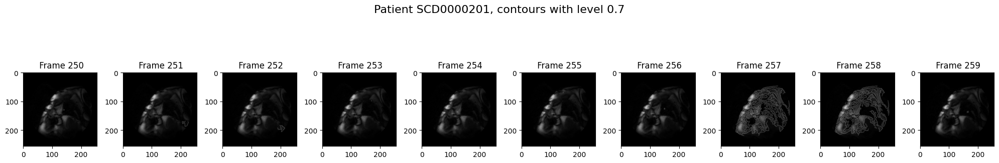

In [ ]:
# num_cols = 10  # Number of images per row

# # Process images in batches of 10
# for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
#     batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
#     num_images = len(batch_filepaths)

#     fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
#     if num_images == 1:
#         axes = [axes]  # Ensure axes is iterable when there's only one image

#     for idx, img_ex_filepath in enumerate(batch_filepaths):
#         # For Google Colab only
#         img_ex_filepath = img_ex_filepath.replace("\\", "/")
#         img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

#         # Read the DICOM image
#         dicom_image = pydicom.dcmread(img_abs_filepath)

#         # Extract the pixel data and convert to 8-bit image
#         image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

#         # Apply gaussian filter
#         image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

#         # Apply contrast
#         img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

#         # Create radial mask for center contrast enhancement
#         # Create a grid of distances from the center
#         rows, cols = img_contrast_gaus.shape
#         center_row, center_col = rows // 2, cols // 2

#         # Create radial distance map
#         y, x = np.ogrid[:rows, :cols]
#         distance_from_center = np.sqrt((x - center_col)**2 + (y - center_row)**2)

#         # Normalize distance to range [0, 1]
#         distance_from_center = distance_from_center / np.max(distance_from_center)

#         # Apply the mask (higher values in the center)
#         radial_mask = 1 - distance_from_center  # Invert to get higher values at the center
#         enhanced_contrast_image = img_contrast_gaus * radial_mask

#         # Edge detection
#         edges_gaus = canny(enhanced_contrast_image, sigma=sigma_edge)

#         # Find and draw contours
#         contours = measure.find_contours(edges_gaus, level=level_val)

#         # Create a binary mask with contours
#         binary_contours_image = np.zeros_like(image, dtype=np.uint8)
#         for contour in contours:
#             # Convert contour to polygon coordinates and fill it in the binary image
#             contour_points = contour.astype(int)
#             rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=binary_contours_image.shape)
#             binary_contours_image[rr, cc] = 255  # Set contour area to foreground (255)

#         # Find the labels in binary mask
#         labeled_image, num_labels = measure.label(binary_contours_image, connectivity=2, return_num=True)

#         # Measure region properties
#         regions = measure.regionprops(labeled_image)

#         # Find smallest eccentricity
#         smallest_eccentricity = float('inf')
#         smallest_eccentricity_region = None

#         for prop in regions:
#             if prop.eccentricity < smallest_eccentricity:
#                 smallest_eccentricity = prop.eccentricity
#                 smallest_eccentricity_region = prop

#         # Create a mask for smallest eccentricity region
#         smallest_eccentricity_mask = np.zeros_like(labeled_image, dtype=np.uint8)
#         smallest_eccentricity_mask[labeled_image == smallest_eccentricity_region.label] = 255

#         # Plot processed image
#         axes[idx].imshow(image, cmap="gray", vmin=np.min(image), vmax=np.max(image))
#         # axes[idx].imshow(edges_gaus, cmap="gray", vmin=np.min(edges_gaus), vmax=np.max(edges_gaus))
#         axes[idx].imshow(smallest_eccentricity_mask, cmap="gray", alpha=0.2)  # Overlay contours on the image
#         axes[idx].set(title=f" Frame {batch_idx}{idx}")

#     plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
#     plt.tight_layout()
#     plt.show()


Using smallest eccentricity, which should coincide with left ventricle, let's obtain the mask for the left ventricle

0 length of dictionary list 0
Min distance: 46.88449319157848

1 length of dictionary list 1
Min distance: 23.791912330661777

2 length of dictionary list 2
Min distance: 34.81068716279138

3 length of dictionary list 3
Min distance: 34.47402219000349

4 length of dictionary list 4
Min distance: 27.88606183103746

5 length of dictionary list 5
Min distance: 43.29346066918103

6 length of dictionary list 6
Min distance: 34.875405738332304

7 length of dictionary list 7
Min distance: 34.45824607839063

8 length of dictionary list 8
Min distance: 34.61821443944007

9 length of dictionary list 9
Min distance: 34.79575838392213



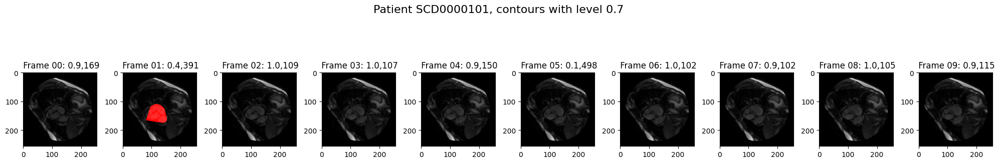

10 length of dictionary list 10
Min distance: 34.803398106549984

11 length of dictionary list 11
Min distance: 47.28167939088832

12 length of dictionary list 12
Min distance: 36.11416859179956

13 length of dictionary list 13
Min distance: 35.81589368226052

14 length of dictionary list 14
Min distance: 35.943474253108754

15 length of dictionary list 15
Min distance: 35.15872516012101

16 length of dictionary list 16
Min distance: 35.293707388853335

17 length of dictionary list 17
Min distance: 35.781541307594715

18 length of dictionary list 18
Min distance: 46.102219598631464

19 length of dictionary list 19
Min distance: 44.359577000805565



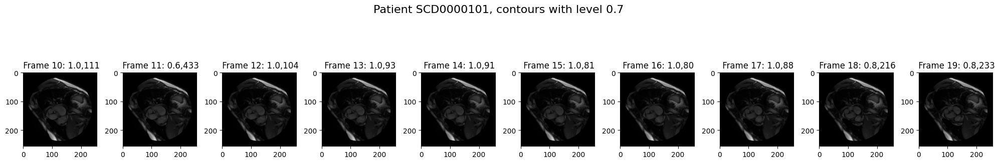

20 length of dictionary list 20
Min distance: 56.786822142311955

21 length of dictionary list 21
Min distance: 34.9560616317167

22 length of dictionary list 22
Min distance: 34.56499671085052

23 length of dictionary list 23
Min distance: 36.156181394501616

24 length of dictionary list 24
Min distance: 36.739461075718395

25 length of dictionary list 25
Min distance: 38.04779489603505

26 length of dictionary list 26
Min distance: 35.412828750082134

27 length of dictionary list 27
Min distance: 35.844134606084836

28 length of dictionary list 28
Min distance: 38.4067040117758

29 length of dictionary list 29
Min distance: 37.768908656819825



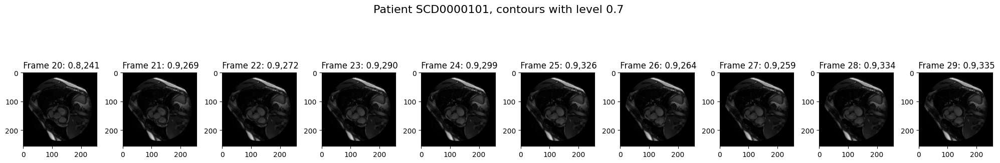

30 length of dictionary list 30
Min distance: 37.879473643594224

31 length of dictionary list 31
Min distance: 37.81242510153754

32 length of dictionary list 32
Min distance: 37.50743914212413

33 length of dictionary list 33
Min distance: 37.69599115433462

34 length of dictionary list 34
Min distance: 37.779149323438915

35 length of dictionary list 35
Min distance: 37.49459831773577

36 length of dictionary list 36
Min distance: 17.820178124674623

37 length of dictionary list 37
Min distance: 3.2088155554209328

38 length of dictionary list 38
Min distance: 1.0068165909021665

39 length of dictionary list 39
Min distance: 0.8958405677243322



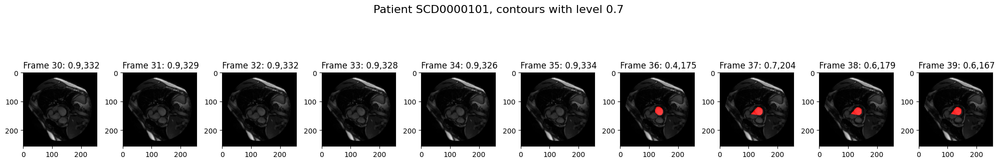

40 length of dictionary list 40
Min distance: 1.0325979830322054

41 length of dictionary list 41
Min distance: 1.4210550002001487

42 length of dictionary list 42
Min distance: 0.6754137040500413

43 length of dictionary list 43
Min distance: 4.375022132613094

44 length of dictionary list 44
Min distance: 0.7479318117315884

45 length of dictionary list 45
Min distance: 0.3194692594462455

46 length of dictionary list 46
Min distance: 0.6609808074807191

47 length of dictionary list 47
Min distance: 0.4139168697018554

48 length of dictionary list 48
Min distance: 1.581034788165233

49 length of dictionary list 49
Min distance: 2.3864863129364973



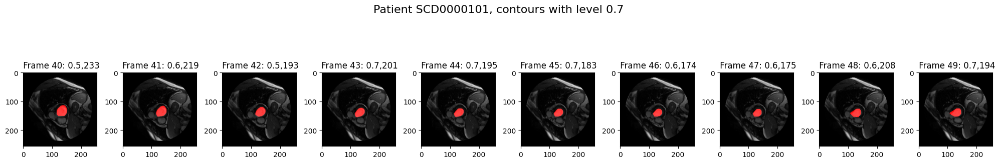

50 length of dictionary list 50
Min distance: 3.9416185820979694

51 length of dictionary list 51
Min distance: 1.3611935124351977

52 length of dictionary list 52
Min distance: 1.0723711326537009

53 length of dictionary list 53
Min distance: 0.6648462596146552

54 length of dictionary list 54
Min distance: 0.674906212094728

55 length of dictionary list 55
Min distance: 1.235927397397069

56 length of dictionary list 56
Min distance: 0.5304751671307967

57 length of dictionary list 57
Min distance: 1.746405814419584

58 length of dictionary list 58
Min distance: 0.5710200936991235

59 length of dictionary list 59
Min distance: 1.0356231682017876



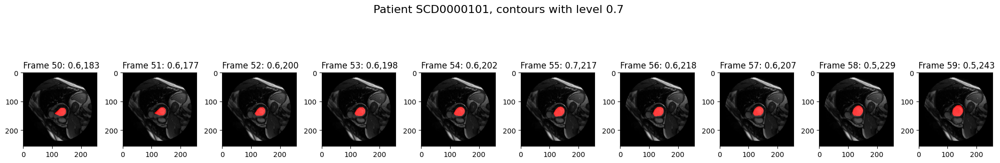

60 length of dictionary list 60
Min distance: 4.0823875589964675

61 length of dictionary list 61
Min distance: 0.8297107872646498

62 length of dictionary list 62
Min distance: 1.2496337180675583

63 length of dictionary list 63
Min distance: 1.5776165448531372

64 length of dictionary list 64
Min distance: 0.9104858350182305

65 length of dictionary list 65
Min distance: 1.3492402212789787

66 length of dictionary list 66
Min distance: 1.124679584698726

67 length of dictionary list 67
Min distance: 0.5166156773734568

68 length of dictionary list 68
Min distance: 0.29460366631552365

69 length of dictionary list 69
Min distance: 2.0447455783829906



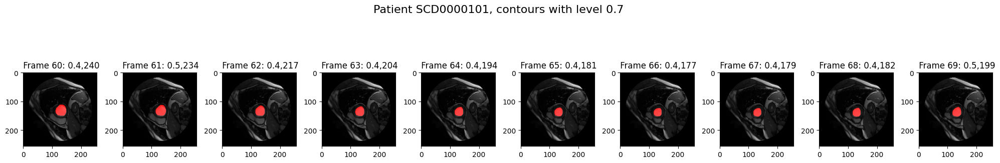

70 length of dictionary list 70
Min distance: 2.5012101360206582

71 length of dictionary list 71
Min distance: 1.82224946024218

72 length of dictionary list 72
Min distance: 0.7682195269660985

73 length of dictionary list 73
Min distance: 0.8394127115769884

74 length of dictionary list 74
Min distance: 0.6451664902229257

75 length of dictionary list 75
Min distance: 0.7316474066248054

76 length of dictionary list 76
Min distance: 0.6200415445122088

77 length of dictionary list 77
Min distance: 1.3522043265545705

78 length of dictionary list 78
Min distance: 0.1999988828769442

79 length of dictionary list 79
Min distance: 1.1127425082642437



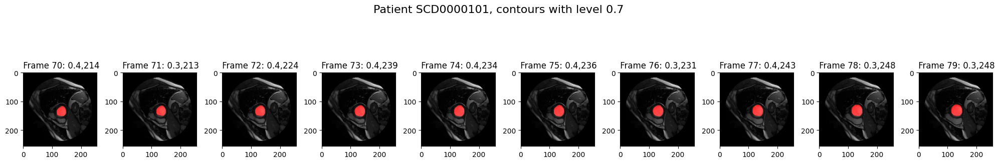

80 length of dictionary list 80
Min distance: 1.547671197798666

81 length of dictionary list 81
Min distance: 0.48403089823130385

82 length of dictionary list 82
Min distance: 0.4462297257188657

83 length of dictionary list 83
Min distance: 1.5906170342017025

84 length of dictionary list 84
Min distance: 0.8722225734377687

85 length of dictionary list 85
Min distance: 56.0366314891557

86 length of dictionary list 86
Min distance: 6.839272514772062

87 length of dictionary list 87
Min distance: 0.06263733968210472

88 length of dictionary list 88
Min distance: 0.243864867374214

89 length of dictionary list 89
Min distance: 7.172374529121396



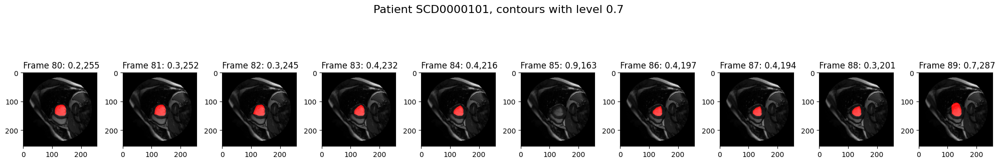

90 length of dictionary list 90
Min distance: 3.6147977117438423

91 length of dictionary list 91
Min distance: 1.2952598891877836

92 length of dictionary list 92
Min distance: 0.25737315418506496

93 length of dictionary list 93
Min distance: 0.892218135395801

94 length of dictionary list 94
Min distance: 0.47626393625560537

95 length of dictionary list 95
Min distance: 0.4632614731244105

96 length of dictionary list 96
Min distance: 0.4209805918621438

97 length of dictionary list 97
Min distance: 0.32804450324308926

98 length of dictionary list 98
Min distance: 0.8445680321674908

99 length of dictionary list 99
Min distance: 0.4307913723770953



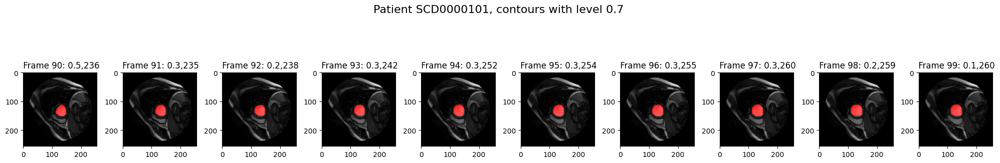

100 length of dictionary list 100
Min distance: 3.4485035532545996

101 length of dictionary list 101
Min distance: 0.42132755153909957

102 length of dictionary list 102
Min distance: 0.6882989481360857

103 length of dictionary list 103
Min distance: 0.40767134742299155

104 length of dictionary list 104
Min distance: 0.2167203008447705

105 length of dictionary list 105
Min distance: 0.9494112335009521

106 length of dictionary list 106
Min distance: 0.40197446185717567

107 length of dictionary list 107
Min distance: 0.22153592951641896

108 length of dictionary list 108
Min distance: 0.3746820828251695

109 length of dictionary list 109
Min distance: 0.8515339995421551



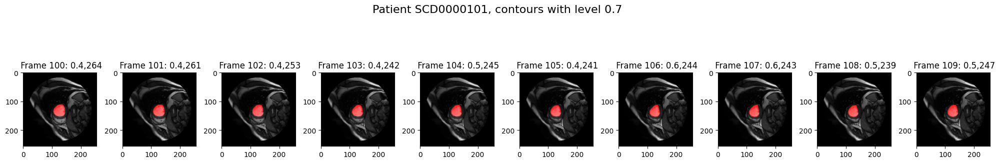

110 length of dictionary list 110
Min distance: 0.8582483275372631

111 length of dictionary list 111
Min distance: 0.6944260482092844

112 length of dictionary list 112
Min distance: 0.2006114662667608

113 length of dictionary list 113
Min distance: 0.6065773561756697

114 length of dictionary list 114
Min distance: 0.46569350589443603

115 length of dictionary list 115
Min distance: 0.46450381995008005

116 length of dictionary list 116
Min distance: 0.5134218275333162

117 length of dictionary list 117
Min distance: 0.6410711590425066

118 length of dictionary list 118
Min distance: 0.6284822470122308

119 length of dictionary list 119
Min distance: 0.2076210131558701



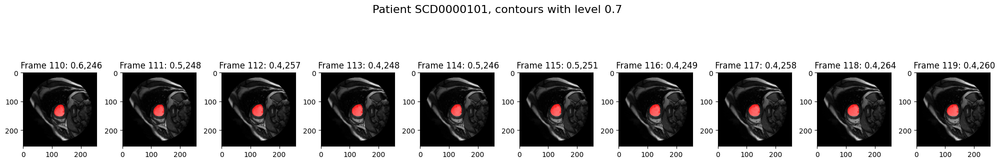

120 length of dictionary list 120
Min distance: 3.260347435398805

121 length of dictionary list 121
Min distance: 0.12282012079098567

122 length of dictionary list 122
Min distance: 0.23060614520484493

123 length of dictionary list 123
Min distance: 0.8883769226240956

124 length of dictionary list 124
Min distance: 0.12158984632246025

125 length of dictionary list 125
Min distance: 0.2147712669876844

126 length of dictionary list 126
Min distance: 1.037834052350519

127 length of dictionary list 127
Min distance: 0.19544828168885592

128 length of dictionary list 128
Min distance: 0.3201982892590832

129 length of dictionary list 129
Min distance: 0.7640661629227683



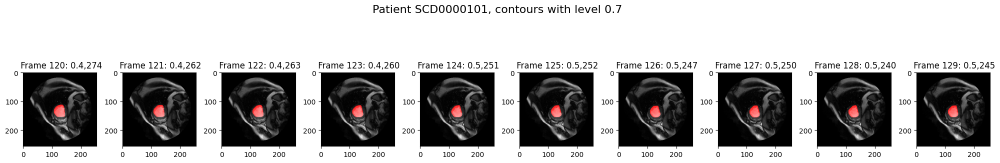

130 length of dictionary list 130
Min distance: 0.6840177675687709

131 length of dictionary list 131
Min distance: 0.6559322670324218

132 length of dictionary list 132
Min distance: 0.6997493168208432

133 length of dictionary list 133
Min distance: 0.33926944922025093

134 length of dictionary list 134
Min distance: 0.05996892245228032

135 length of dictionary list 135
Min distance: 0.6709208669348268

136 length of dictionary list 136
Min distance: 0.37443800117994

137 length of dictionary list 137
Min distance: 0.28454985522269055

138 length of dictionary list 138
Min distance: 0.21213002565057687

139 length of dictionary list 139
Min distance: 0.4254770228823166



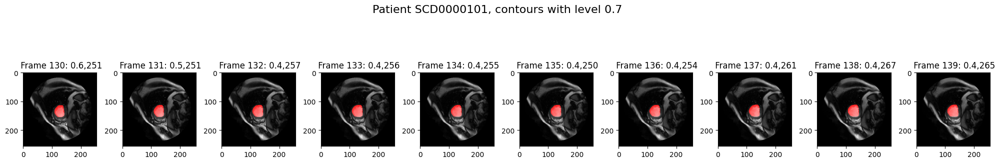

140 length of dictionary list 140
Min distance: 2.9711229822821856

141 length of dictionary list 141
Min distance: 0.7813934182145352

142 length of dictionary list 142
Min distance: 0.21281612979882153

143 length of dictionary list 143
Min distance: 0.6054969536456082

144 length of dictionary list 144
Min distance: 0.26868535221124973

145 length of dictionary list 145
Min distance: 0.28511037959807234

146 length of dictionary list 146
Min distance: 0.4760571152743979

147 length of dictionary list 147
Min distance: 0.1260610653369436

148 length of dictionary list 148
Min distance: 0.039047479089875055

149 length of dictionary list 149
Min distance: 0.515016528640543



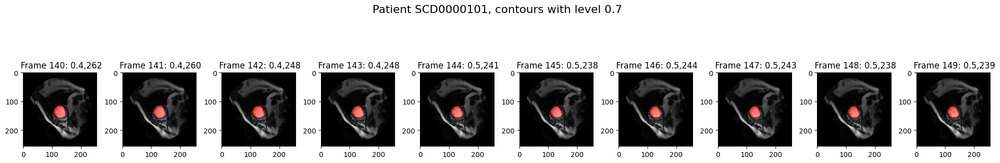

150 length of dictionary list 150
Min distance: 0.4361411395066355

151 length of dictionary list 151
Min distance: 0.23439045708801187

152 length of dictionary list 152
Min distance: 0.9253874617307747

153 length of dictionary list 153
Min distance: 0.3003804771976403

154 length of dictionary list 154
Min distance: 0.1371947526201014

155 length of dictionary list 155
Min distance: 0.1183931802426798

156 length of dictionary list 156
Min distance: 0.18188464481930394

157 length of dictionary list 157
Min distance: 0.19835644403682917

158 length of dictionary list 158
Min distance: 0.2818518343407339

159 length of dictionary list 159
Min distance: 0.4079369933154526



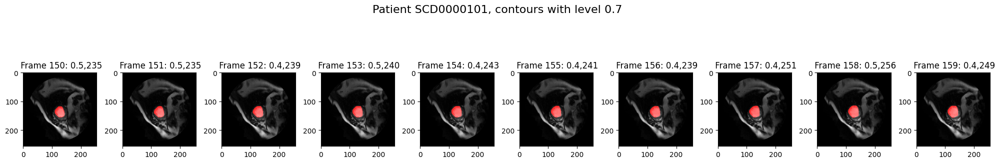

160 length of dictionary list 160
Min distance: 1.1386985624235189

161 length of dictionary list 161
Min distance: 0.15451250541692513

162 length of dictionary list 162
Min distance: 0.2995054987441297

163 length of dictionary list 163
Min distance: 0.1720286012014514

164 length of dictionary list 164
Min distance: 0.5965672524372028

165 length of dictionary list 165
Min distance: 0.21297798752312666

166 length of dictionary list 166
Min distance: 0.14025647861582502

167 length of dictionary list 167
Min distance: 0.17348643268444436

168 length of dictionary list 168
Min distance: 0.20310865150826002

169 length of dictionary list 169
Min distance: 0.07005728398308336



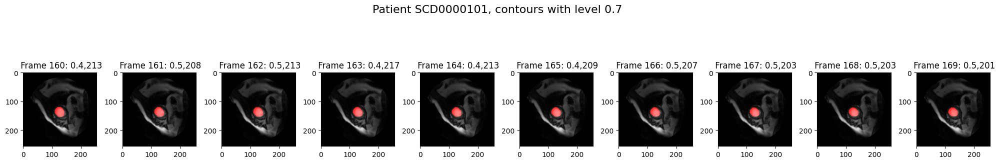

170 length of dictionary list 170
Min distance: 0.42480606645566493

171 length of dictionary list 171
Min distance: 0.11865564016712447

172 length of dictionary list 172
Min distance: 0.30666370254347763

173 length of dictionary list 173
Min distance: 0.3945713500270859

174 length of dictionary list 174
Min distance: 0.21045861288649279

175 length of dictionary list 175
Min distance: 0.5536372784630668

176 length of dictionary list 176
Min distance: 0.4180744871419009

177 length of dictionary list 177
Min distance: 0.18795112609873896

178 length of dictionary list 178
Min distance: 0.23383940430600839

179 length of dictionary list 179
Min distance: 0.2071576595212154



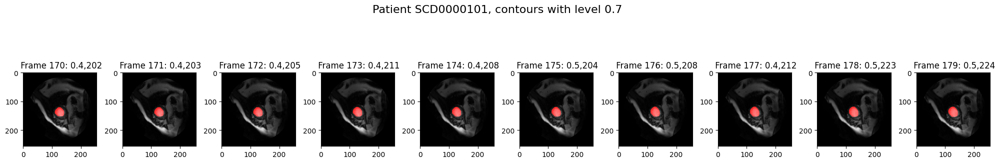

180 length of dictionary list 180
Min distance: 0.8333074093662496

181 length of dictionary list 181
Min distance: 0.13456710901797928

182 length of dictionary list 182
Min distance: 0.28216488950797153

183 length of dictionary list 183
Min distance: 0.20373942539044315

184 length of dictionary list 184
Min distance: 0.3535982119599327

185 length of dictionary list 185
Min distance: 0.19694785651044225

186 length of dictionary list 186
Min distance: 0.25241707620971693

187 length of dictionary list 187
Min distance: 0.261586122959328

188 length of dictionary list 188
Min distance: 0.33445122946666234

189 length of dictionary list 189
Min distance: 0.4527331743357649



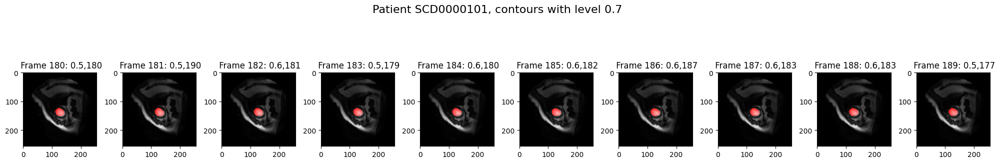

190 length of dictionary list 190
Min distance: 0.6128993134408409

191 length of dictionary list 191
Min distance: 0.10409952624096044

192 length of dictionary list 192
Min distance: 0.5435394115547882

193 length of dictionary list 193
Min distance: 0.27296140268557206

194 length of dictionary list 194
Min distance: 0.08741435329036287

195 length of dictionary list 195
Min distance: 0.3094118453786746

196 length of dictionary list 196
Min distance: 0.3475839189891926

197 length of dictionary list 197
Min distance: 0.40682531316594117

198 length of dictionary list 198
Min distance: 0.33113509609871544

199 length of dictionary list 199
Min distance: 0.3712802230559992



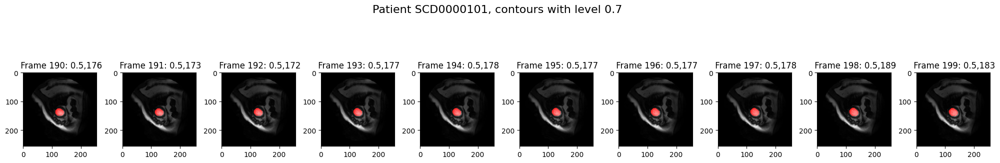

200 length of dictionary list 200
Min distance: 38.336931465054036

201 length of dictionary list 201
Min distance: 37.531982990498655

202 length of dictionary list 202
Min distance: 39.54028678417576

203 length of dictionary list 203
Min distance: 39.06057428927454

204 length of dictionary list 204
Min distance: 38.63915769369933

205 length of dictionary list 205
Min distance: 45.573115054059016

206 length of dictionary list 206
Min distance: 38.401644158280234

207 length of dictionary list 207
Min distance: 45.18508973760789

208 length of dictionary list 208
Min distance: 45.56343851875173

209 length of dictionary list 209
Min distance: 38.5678673482147



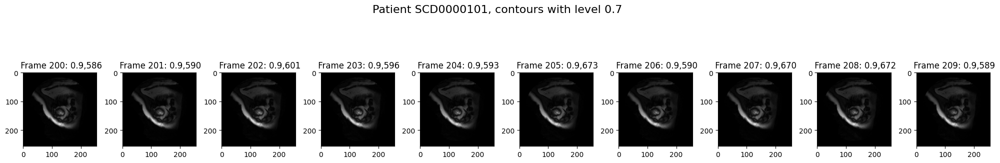

210 length of dictionary list 210
Min distance: 45.00143494826414

211 length of dictionary list 211
Min distance: 38.0878394673052

212 length of dictionary list 212
Min distance: 38.01233532813968

213 length of dictionary list 213
Min distance: 39.01331144427302

214 length of dictionary list 214
Min distance: 38.16031801328251

215 length of dictionary list 215
Min distance: 37.52945401733851

216 length of dictionary list 216
Min distance: 38.29831214253987

217 length of dictionary list 217
Min distance: 46.15305883046353

218 length of dictionary list 218
Min distance: 45.865903304609084

219 length of dictionary list 219
Min distance: 45.903586342192604



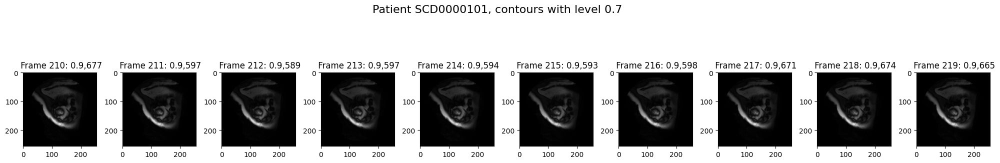

220 length of dictionary list 220
Min distance: 28.86043884940556

221 length of dictionary list 221
Min distance: 23.594641213455045

222 length of dictionary list 222
Min distance: 23.500084791470037

223 length of dictionary list 223
Min distance: 23.792233672250145

224 length of dictionary list 224
Min distance: 29.30485172637929

225 length of dictionary list 225
Min distance: 29.160662369862806

226 length of dictionary list 226
Min distance: 29.150244887669345

227 length of dictionary list 227
Min distance: 29.512797116647356

228 length of dictionary list 228
Min distance: 28.698319422492823

229 length of dictionary list 229
Min distance: 28.784302627881164



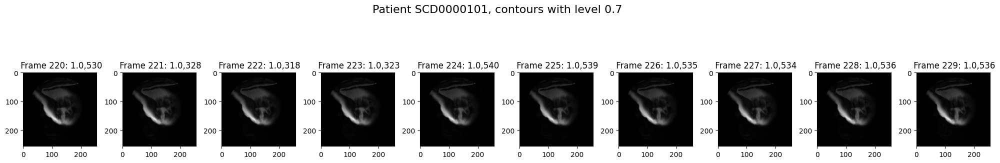

230 length of dictionary list 230
Min distance: 28.488426255122043

231 length of dictionary list 231
Min distance: 28.470640363714722

232 length of dictionary list 232
Min distance: 29.066454495661112

233 length of dictionary list 233
Min distance: 29.100106269651306

234 length of dictionary list 234
Min distance: 29.642780228794027

235 length of dictionary list 235
Min distance: 28.743614094980522

236 length of dictionary list 236
Min distance: 29.435573483236443

237 length of dictionary list 237
Min distance: 28.41110182737528

238 length of dictionary list 238
Min distance: 28.569585504283573

239 length of dictionary list 239
Min distance: 28.779672751994777



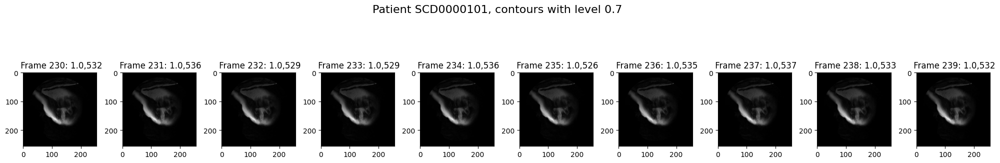

In [ ]:
num_cols = 10  # Number of images per row
from skimage.morphology import convex_hull_image

patient_seed_starter = [(130,80), (120,90), (120,90), (120,90)]

mask_info_dict = {
    "index": [],
    "frames": [],
    "eccentricity": [],
    "area": [],
    "coords": [],
    "centroid_coords": [],
}


# Process images in batches of 10
for batch_idx, batch_start in enumerate(range(0, len(single_patient_filepaths), num_cols)):
    batch_filepaths = single_patient_filepaths[batch_start:batch_start + num_cols]
    num_images = len(batch_filepaths)

    fig, axes = plt.subplots(1, num_images, figsize=(num_images * 2, 4))
    if num_images == 1:
        axes = [axes]  # Ensure axes is iterable when there's only one image

    for idx, img_ex_filepath in enumerate(batch_filepaths):
        image_idx = int(f"{batch_idx}{idx}")
        print(image_idx, "length of dictionary list",len(mask_info_dict['centroid_coords']))
        # For Google Colab only
        img_ex_filepath = img_ex_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_ex_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        image = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Apply gaussian filter
        image_blurred_gaus = filters.gaussian(image, sigma=sigma_blur)

        # Apply contrast
        img_contrast_gaus = exposure.equalize_adapthist(image_blurred_gaus, clip_limit=clip_limit_val)

        # Create radial mask for center contrast enhancement
        # Create a grid of distances from the center
        rows, cols = img_contrast_gaus.shape
        center_row, center_col = rows // 2, cols // 2

        # Create radial distance map
        y, x = np.ogrid[:rows, :cols]
        distance_from_center = np.sqrt((x - center_col)**2 + (y - center_row)**2)

        # Normalize distance to range [0, 1]
        distance_from_center = distance_from_center / np.max(distance_from_center)

        # Apply the mask (higher values in the center)
        radial_mask = 1 - distance_from_center  # Invert to get higher values at the center
        enhanced_contrast_image = img_contrast_gaus * radial_mask

        # Edge detection
        edges_gaus = canny(enhanced_contrast_image, sigma=sigma_edge)

        # Find and draw contours
        contours = measure.find_contours(edges_gaus, level=level_val)

        # Create a binary mask with contours
        binary_contours_image = np.zeros_like(image, dtype=np.uint8)
        for contour in contours:
            # Convert contour to polygon coordinates and fill it in the binary image
            contour_points = contour.astype(int)
            rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=binary_contours_image.shape)
            binary_contours_image[rr, cc] = 255  # Set contour area to foreground (255)


        # Find the labels in binary mask
        labeled_image, num_labels = measure.label(binary_contours_image, connectivity=2, return_num=True)

        # Measure region properties
        regions = measure.regionprops(labeled_image)

        # Find smallest eccentricity
        smallest_eccentricity = float('inf')
        smallest_eccentricity_region = None
        area_of_smallest_eccentricity_region = 0
        min_distance = float('inf')
        best_region = None

        for prop in regions:
            # Compare the centroid from the dictionary if it exists
            if mask_info_dict['centroid_coords']:
                previous_centroid = np.array(mask_info_dict['centroid_coords'][image_idx-1])
                current_centroid = np.array(prop.centroid)
                distance = np.linalg.norm(current_centroid - previous_centroid)  # Euclidean distance

                if distance < min_distance:
                    min_distance = distance
                    best_region = prop
                    area_of_smallest_eccentricity_region = prop.area
                    smallest_eccentricity = prop.eccentricity
                    smallest_eccentricity_region = prop
            else:
              if prop.eccentricity < smallest_eccentricity:
                smallest_eccentricity = prop.eccentricity
                smallest_eccentricity_region = prop
                area_of_smallest_eccentricity_region = prop.area

        # # Append the dictionary info
        # if mask_info_dict["centroid_coords"]:
        #     mask_info_dict["index"].append(int(f"{batch_idx}{idx}"))
        #     mask_info_dict["frames"].append(img_ex_filepath)
        #     mask_info_dict["eccentricity"].append(smallest_eccentricity)
        #     mask_info_dict["area"].append(area_of_smallest_eccentricity_region)
        #     mask_info_dict["coords"].append(smallest_eccentricity_region.coords)
        #     mask_info_dict["centroid_coords"].append(smallest_eccentricity_region.centroid)

        # Create a mask for smallest eccentricity region
        smallest_eccentricity_mask = np.zeros_like(labeled_image, dtype=np.uint8)
        smallest_eccentricity_mask[labeled_image == smallest_eccentricity_region.label] = 255

        # Obtain the filled mask
        filled_mask = np.zeros_like(smallest_eccentricity_mask, dtype=np.uint8)

        # Generate convex hull mask
        hull_mask = convex_hull_image(smallest_eccentricity_mask)

        # Find contours in the smallest_eccentricity_mask
        contours = measure.find_contours(hull_mask, level=0.5)

        # Loop through each contour and fill it in the mask
        for contour in contours:
            # Convert contour coordinates to integer values
            contour_points = contour.astype(int)

            # Get the coordinates of the contour and fill the polygon
            rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=filled_mask.shape)

            # Set the region inside the polygon to 255 (foreground)
            filled_mask[rr, cc] = 255  # Set filled region to white (255)

        # Plot the overlay
        # Normalize original image for proper display (optional)
        image = image.astype(np.float32)
        image = (image - image.min()) / (image.max() - image.min())  # Normalize to [0,1] range

        # Create an RGB version of the grayscale image
        image_rgb = np.stack([image] * 3, axis=-1)  # Convert grayscale to RGB (shape: HxWx3)

        # Create a red-colored mask (overlay will be red where the mask is)
        mask_rgb = np.zeros_like(image_rgb)  # Create an empty RGB image

        # if smallest_eccentricity < 0.8 and area_of_smallest_eccentricity_region < 300: # Patient 0
        # if smallest_eccentricity < 0.8 and area_of_smallest_eccentricity_region < 400: # Patient 2
        if smallest_eccentricity < 0.8 and area_of_smallest_eccentricity_region < 400: # Patient 3,4

          mask_rgb[:, :, 0] = filled_mask  # Red channel

          # Add the needed info if the dictionary is empty
          # if not mask_info_dict["frames"]:
          mask_info_dict["index"].append(int(f"{batch_idx}{idx}"))
          mask_info_dict["frames"].append(img_ex_filepath)
          mask_info_dict["eccentricity"].append(smallest_eccentricity)
          mask_info_dict["area"].append(area_of_smallest_eccentricity_region)
          mask_info_dict["coords"].append(smallest_eccentricity_region.coords)
          mask_info_dict["centroid_coords"].append(smallest_eccentricity_region.centroid)
          # print(mask_info_dict['centroid_coords'][0])

        else:
          smallest_eccentricity = float('inf')
          smallest_eccentricity_region = None
          area_of_smallest_eccentricity_region = 0
          min_distance = float('inf')
          best_region = None
          for prop in regions:
            # Compare the centroid from the dictionary if it exists
            if patient_seed_starter[patient_idx]:
                previous_centroid = np.array(patient_seed_starter[patient_idx])
                current_centroid = np.array(prop.centroid)
                distance = np.linalg.norm(current_centroid - previous_centroid)  # Euclidean distance

                if distance < min_distance:
                    min_distance = distance
                    best_region = prop
                    area_of_smallest_eccentricity_region = prop.area
                    smallest_eccentricity = prop.eccentricity
                    smallest_eccentricity_region = prop

          # Append the dictionary info
          mask_info_dict["index"].append(int(f"{batch_idx}{idx}"))
          mask_info_dict["frames"].append(img_ex_filepath)
          mask_info_dict["eccentricity"].append(smallest_eccentricity)
          mask_info_dict["area"].append(area_of_smallest_eccentricity_region)
          mask_info_dict["coords"].append(smallest_eccentricity_region.coords)
          mask_info_dict["centroid_coords"].append(smallest_eccentricity_region.centroid)

           # Create a mask for smallest eccentricity region
          smallest_eccentricity_mask = np.zeros_like(labeled_image, dtype=np.uint8)
          smallest_eccentricity_mask[labeled_image == smallest_eccentricity_region.label] = 255

          # Obtain the filled mask
          filled_mask = np.zeros_like(smallest_eccentricity_mask, dtype=np.uint8)

          # Generate convex hull mask
          hull_mask = convex_hull_image(smallest_eccentricity_mask)

          # Find contours in the smallest_eccentricity_mask
          contours = measure.find_contours(hull_mask, level=0.5)

          # Loop through each contour and fill it in the mask
          for contour in contours:
              # Convert contour coordinates to integer values
              contour_points = contour.astype(int)

              # Get the coordinates of the contour and fill the polygon
              rr, cc = polygon(contour_points[:, 0], contour_points[:, 1], shape=filled_mask.shape)

              # Set the region inside the polygon to 255 (foreground)
              filled_mask[rr, cc] = 255  # Set filled region to white (255)

          # if smallest_eccentricity < 0.8 and area_of_smallest_eccentricity_region < 300: # Patient 0
          # if smallest_eccentricity < 0.8 and area_of_smallest_eccentricity_region < 400: # Patient 2
          if smallest_eccentricity < 0.8 and area_of_smallest_eccentricity_region < 400: # Patient 3,4

            mask_rgb[:, :, 0] = filled_mask  # Red channel
          else:
            mask_rgb[:, :, 0] = 0
        # Alpha blending
        print(f"Min distance: {min_distance}\n")
        alpha = 0.05  # Transparency level
        overlay = (image_rgb * (1 - alpha) + mask_rgb * alpha)

        # Ensure values are in valid range [0,1] for display
        overlay = np.clip(overlay, 0, 1)

        # Plot processed image
        axes[idx].imshow(overlay, cmap="gray", vmin=np.min(overlay), vmax=np.max(overlay))
        axes[idx].set(title=f" Frame {batch_idx}{idx}: {smallest_eccentricity:.1f},{area_of_smallest_eccentricity_region:.0f}")

    plt.suptitle(f"Patient {patient_id}, contours with level {level_val}", fontsize=16)
    plt.tight_layout()
    plt.show()


Recommendations from Dr Rodrigo:

Consider 16 bit: did not really work

Hough transform: requires set radius which is hard to determine because there are many circular objects in the image

Temporal component by subtracting consecutive frames from each other: couldn't make it work; Dr Rodrigo recommended setting threshold and trying it.

Snakes: to get the closest shape possible from disrupted and unclear edges of the left ventricle


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.lines as mlines
import skimage as ski


def store_evolution_in(lst):
    """Returns a callback function to store the evolution of the level sets in
    the given list.
    """

    def _store(x):
        lst.append(np.copy(x))

    return _store


def apply_contrast_enhancement(img, clip_limit):
    # Apply contrast
    img_contrast = exposure.equalize_adapthist(img, clip_limit=clip_limit)

    # Create radial mask for center contrast enhancement
    # Create a grid of distances from the center
    rows, cols = img_contrast.shape
    center_row, center_col = rows//2, cols//2

    # Create radial distance map
    y, x = np.ogrid[:rows, :cols]
    distance_from_center = np.sqrt((x - center_col)**2 + (y - center_row)**2)

    # Normalize distance to range [0, 1]
    distance_from_center = distance_from_center / np.max(distance_from_center)

    # Apply the mask (higher values in the center)
    radial_mask = 1 - distance_from_center  # Invert to get higher values at the center
    enhanced_contrast_img = img_contrast * radial_mask

    return enhanced_contrast_img

In [31]:
# Select the patient whose left ventricle was not properly segmented: 19

patient_num = 1

patient_ids = patient_filepaths_df['patient_id'].unique()

patient_to_check = patient_ids[patient_num]
patient_imgs = patient_filepaths_df[patient_filepaths_df['patient_id'] == patient_to_check]

patient_filepaths = patient_imgs['dcm_image_filepath'].tolist()

print(f"Patient is {patient_to_check}")
print(f"Number of images: {len(patient_filepaths)}")

img_to_analyze = 150
img_filepath = patient_filepaths[img_to_analyze]

# For Google Colab only
img_filepath = img_filepath.replace("\\", "/")
img_abs_filepath = os.path.join(user_handle_g_collab, img_filepath)

# patient 1
img_processing_params = {'eccentricity': 0.8, 'area': 300, 'seed_starter': (130, 130), 'sigma_gaus': 0.05, 'clip_limit': 0.03, 'sigma_edge': 6.3, 'level': 0.7, 'distance_centroid_th': 20}

# patient 19
img_processing_params = {'eccentricity': 0.8, 'area': 300, 'seed_starter': (130, 130), 'sigma_gaus': 0.05, 'clip_limit': 0.03, 'sigma_edge': 6.3, 'level': 0.7, 'distance_centroid_th': 20}


# Snakes params
num_iter_img = 130
radius_snakes = 10

Patient is SCD0000201
Number of images: 260


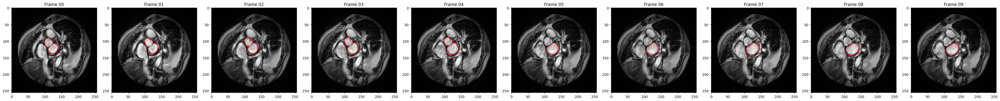

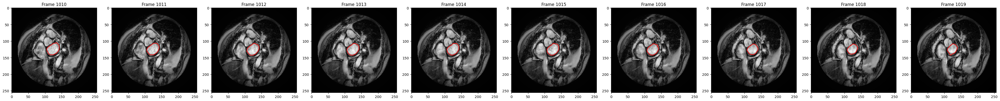

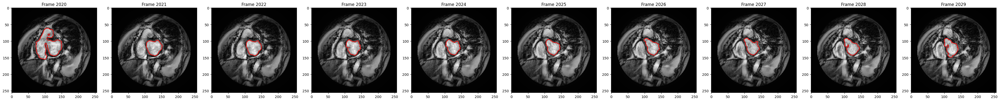

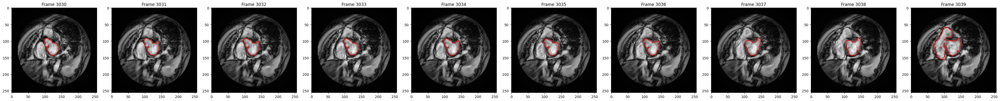

KeyboardInterrupt: 

In [36]:
import os
import pydicom
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, segmentation, img_as_ubyte
from skimage.feature import canny

batch_size = 10

# Iterate over the file paths in batches of 10
for batch_start in range(0, len(patient_filepaths), batch_size):
    batch = patient_filepaths[batch_start: batch_start + batch_size]

    fig, axes = plt.subplots(1, batch_size, figsize=(batch_size * 4, 4))  # 10 images in one row

    if batch_size == 1:
        axes = [axes]  # Ensure axes is always iterable when batch_size = 1

    for img_idx, (img_filepath, ax) in enumerate(zip(batch, axes), start=batch_start):
        # For Google Colab only
        img_filepath = img_filepath.replace("\\", "/")
        img_abs_filepath = os.path.join(user_handle_g_collab, img_filepath)

        # Read the DICOM image
        dicom_image = pydicom.dcmread(img_abs_filepath)

        # Extract the pixel data and convert to 8-bit image
        img_8bit = img_as_ubyte(dicom_image.pixel_array / np.max(dicom_image.pixel_array))

        # Get filtered image
        img_filt = filters.gaussian(img_8bit, sigma=img_processing_params['sigma_gaus'])

        # Apply radial contrast enhancement
        img_contrast = apply_contrast_enhancement(img_filt, img_processing_params['clip_limit'])

        # Edge detection
        img_edges = canny(img_contrast, sigma=img_processing_params['sigma_edge'])

        image = img_contrast

        # Initial level set
        init_ls = segmentation.disk_level_set(image.shape, center=img_processing_params['seed_starter'], radius=radius_snakes)

        # Store evolution of segmentation
        evolution = []
        callback = store_evolution_in(evolution)
        ls = segmentation.morphological_chan_vese(image, num_iter=num_iter_img, init_level_set=init_ls, iter_callback=callback)

        ls_acwe = evolution[num_iter_img]  # ACWE result

        # Plot results
        ax.imshow(image, cmap="gray")
        ax.contour(ls, [0.5], colors='r')
        ax.set_title(f"Frame {batch_start}{img_idx}", fontsize=12)
        # ax.set_xticks([])  # Remove x-axis ticks
        # ax.set_yticks([])  # Remove y-axis ticks

    plt.tight_layout()
    plt.show()
